# There's Waldo

This notebook contains my end-to-end process for building a neural network to find Waldo (or Wally) in a classic Where's Waldo picture.

The dataset consists of 18 "high" resolution Where's Waldo images taken from Valentino Constantinou's [Hey Waldo](https://github.com/vc1492a/Hey-Waldo) repository.

The approach I've taken is to formulate this entire task as semantic segmentation, which is a fancy phrase for pixel-level classification. In this case, the classes are: Waldo, not-Waldo. The architecture I used is Jégou et. al's [The One Hundred Layers Tiramisu: Fully Convolutional DenseNets for Semantic Segmentation](https://arxiv.org/abs/1611.09326). 

Before starting this notebook, you need to have bounding box xml files. These are included for you, however if you'd like to add a new image to the training set, I used tzutalin's [labelImg](https://github.com/tzutalin/labelImg). This allows you to manually set bounding boxes, and saves it in PASCAL VOC format, the format used by ImageNet.

## Setup

In [19]:
import glob
from PIL import Image
import os
from keras.preprocessing import image
from keras.utils import to_categorical
import threading
from numpy import random
from bs4 import BeautifulSoup
import scipy
import matplotlib.pyplot as plt
import numpy as np
import os

%matplotlib inline

Using TensorFlow backend.


File paths

In [20]:
IMG_PATH = "imgs/original_imgs/"
XML_PATH = "imgs/bnd_box/"
TRG_PATH = "imgs/target_imgs/"
FULL_PRED_PATH = "imgs/full_predictions/"
NEW_PATH = "imgs/new_imgs/"

**NOTE:** Many images being loaded for viewing purposes are not in the repo. However you have everything you need to replicate this process.

## Build Targets

Since this is a semantic segmentation task, not bounding box regression, we need to actually create (in this case binary) target images from our bounding box XML.

Helper functions for loading xml files.

In [3]:
def get_img_num(img_file):
    return os.path.basename(img_file).split('.')[0]

def grab_xml_file(img_file):
    i = get_img_num(img_file)
    return XML_PATH+i+'.xml'

This extracts the location of the bounding box from the xml. This will work for multiple bounding boxes, **however** if you would like to use more than one box you'll have to modify some code later on, as I assume there is only one per image.

In [4]:
def decode_bndbox(xml):
    soup = BeautifulSoup(xml, 'xml')
    boxes = []
    for box in soup.annotation.find_all('bndbox'):
        boxes.append((int(box.xmin.contents[0]), int(box.xmax.contents[0]), int(box.ymin.contents[0]), int(box.ymax.contents[0])))
    return boxes

This next function creates target image arrays and then saves them as .png files.

In [5]:
def make_target(img_file, boxes):
    img = Image.open(img_file)
    img_array = image.img_to_array(img, data_format='channels_last')
    shp = img_array.shape
    target = np.zeros(shp)
    for box in boxes:
        xmin, xmax, ymin, ymax = box
        target[ymin:ymax,xmin:xmax, :] = 1
    return target

Since these are just targets to be used for training, why do we need to save them in image format? 

We are going to want to resize the original images. Once we do that, the input image and target array are no longer consistent. The *easiest* way to maintain consistency between the resized image and the target array is to simply save the target array as an image as well, and resize it in the exact same manner.

Now we iterate through all xml files and create/save target images appropriately.

In [15]:
img_files = glob.glob(IMG_PATH+"*.jpg")
for img in img_files:
    xml_file = grab_xml_file(img)
    i = get_img_num(xml_file)
    with open(xml_file, mode='r') as f:
        raw_xml = f.read()
    boxes = decode_bndbox(raw_xml)
    target = make_target(img, boxes)
    scipy.misc.imsave(TRG_PATH+i+'.png', target)

Let's take a look at an example image.

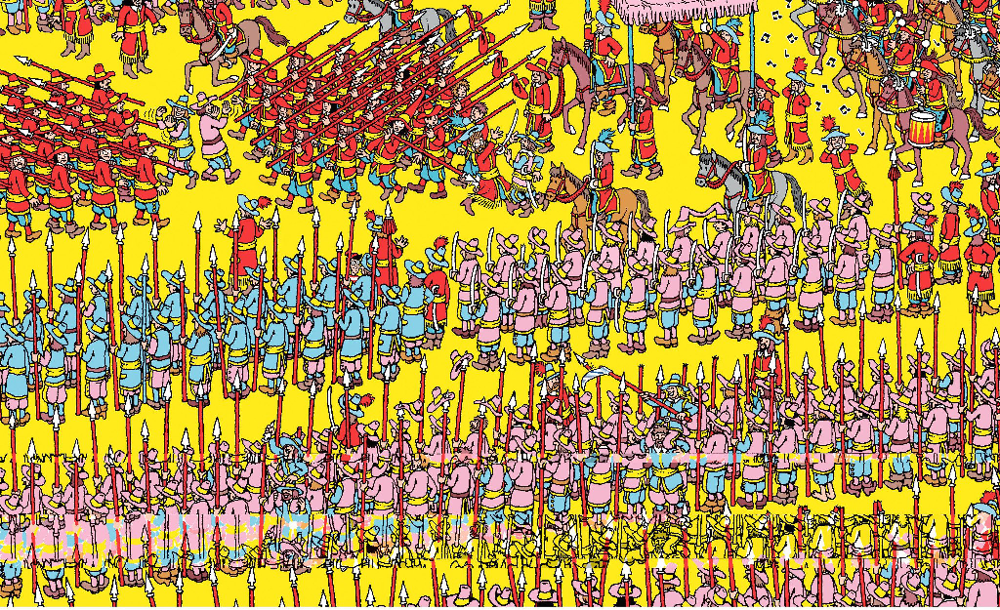

In [13]:
im = Image.open(IMG_PATH+'1.jpg')
im.resize((im.size[0]//2, im.size[1]//2))

Here is an example target.

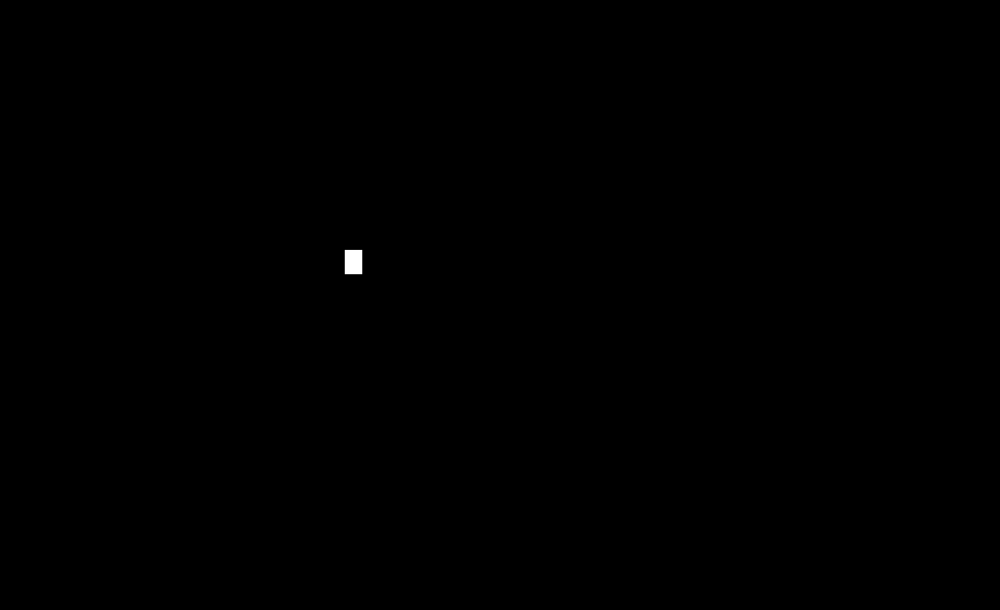

In [14]:
im = Image.open(TRG_PATH+'1.png')
im.resize((im.size[0]//2, im.size[1]//2))

## Preprocessing

Now that we've built and saved our target images, we're going to load in a constant size, preprocess, and save the arrays.

First we're going to load the original image files.

In [21]:
get_img_num = lambda img_file: int(os.path.basename(img_file).split('.')[0])

In [22]:
trg_files = sorted(glob.glob(TRG_PATH+"*.png"),key=get_img_num)
img_files = sorted(glob.glob(IMG_PATH+"*.jpg"),key=get_img_num)

I'm going to load them all into the same resolution. I've selected the resolution below because it is the largest of the original images.

The reason I'm resizing upward instead of downward is because of how "dense" these images are with illustration. If I downsample the larger images, Waldo won't be discernible.

In [23]:
img_sz = (2800, 1760)

In [24]:
def load_image(img, img_sz=None): 
    if img_sz:
        return np.array(Image.open(img).resize(img_sz, Image.NEAREST))
    else:
        return np.array(Image.open(img))

We're loading the label images in grayscale.

In [25]:
def load_label(img, img_sz): return np.array(Image.open(img).convert("L").resize(img_sz, Image.NEAREST))

Load and concatenate into single array.

In [21]:
imgs = np.stack([load_image(img_file, img_sz) for img_file in img_files])

labels = np.stack([load_label(trg_file, img_sz) for trg_file in trg_files])

As is standard procedure, we're going to normalize pixel values from 0-255 scale to the unit interval.

Likewise, we're going to standardize our inputs.

In [22]:
imgs = imgs/255.

labels = labels/255

mu = np.mean(imgs)

# mu = 0.57729064767952254

std = np.std(imgs)

# std = 0.31263486676782137

imgs -= mu

imgs /=std

In [45]:
mu = 0.57417726724528806
std = 0.31263486676782137

Save the arrays.

In [ ]:
np.save('imgs.npy', imgs)
np.save('labels.npy', labels)

Let's double check

In [26]:
imgs = np.load('imgs.npy')
labels = np.load('labels.npy')

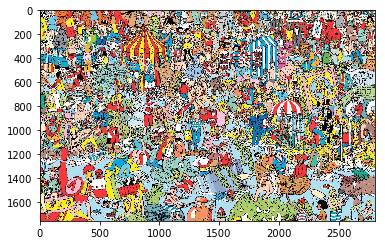

In [8]:
plt.imshow(imgs[-2]*std + mu)

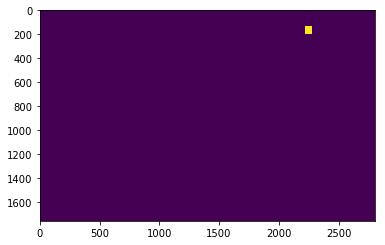

In [9]:
plt.imshow(labels[-2])

## Data Generation Overview

Before moving to the next steps, I'd like to give some context on what we'll be doing.

So far, we have created 18 targets for our 18 images. Alone, this isn't remotely close to the amount of data we need to train an architecture like this.

However, these images are very large. A smart approach would be to dynamically generate random sample images from these larger images while training (w/ corresponding sub-labels).

We're going to use a sample image size of 224x224. Given each input image is 2800x1760, there are approximately 4 million unique sample images per input image. Add in random horizontal flips, and there are approx. 142 million unique sample images, which is more than enough.

This also addresses resource allocation concerns. Theoretically, fully-convolutional neural networks are compatible with any resolution. In practice, a 2800x1760 image is way too large an input for this network. Even half that resolution is likely too large. Sampling sub-images of 224x224 easily moves us past this problem.

There is one final concern; will a sub-image of 224x224 from such a large image contain the information necessary to detect Waldo?

Fortunately, Waldo's face is of course going to be incredibly small, and in general it's ~ 60x60.

It's important that the sub-image is large enough to capture the entire target. Convolutional layers rely on local information; if the sub-images could only capture Waldo's nose or an eye, it won't have enough local information (hat, hair) to determine that it is Waldo. 

## Create Waldo Sub-images

Before building the generators to extract sample images, we need to create Waldo sub-images. These are the 18 sub-images such that every 224x224 sample has a complete target in it (contains a complete picture of Waldo).

This is necessary for two reasons:

* Even in 224x224 sample images that contain Waldo, class imbalance is a significant issue. Taken with the very low odds of randomly sampling a Waldo image from the original, a network trained solely on random samples will never be **sensitive**.
* Even if we did manage to up-sample the sample images containing a target, we are likely to encounter target edges (e.g. the tip of Waldo's hat). Such an image wouldn't contain the local information necessary to distinguish Waldo and would just confuse the network.

Let's start by selecting some label.

In [24]:
l = labels[0]

We need to find two things: where the box starts in each dimension, and how long it is in that dimension. Because the targets are binary, we can find the length in a dimension by summing across that axis, and we can find where they start similarly.

In [25]:
h = np.max(np.unique(l.sum(axis=1)))

hstart = np.argmax(l.sum(axis=0))

hend = int(hstart+h)

In [26]:
hend

1016

In [27]:
hstart

965

In [28]:
w = np.max(np.unique(l.sum(axis=0)))

wstart = np.argmax(l.sum(axis=1))

wend = int(wstart+w)

We'll check to make sure this worked. h&w are the box dims we calculated

In [29]:
a = h*w

In [30]:
a

3519

In [31]:
w, h

(69, 51)

Since every pixel in the box has value 1 and those outside are 0, a sum over the entire image should be the same, which it is.

In [32]:
np.sum(l)

3519

Now we can check to see if the range values we've calculated captures the box exactly.

It has the same shape.

In [33]:
l[wstart:wend,hstart:hend].shape

(69, 51)

And the same sum as the total image, meaning it's completely captured the box.

In [34]:
np.sum(l[wstart:wend,hstart:hend])

3519

We can use these range values on the input image to see if we capture Waldo, as a sanity check.

Perfect!

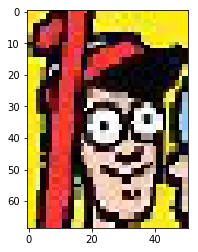

In [36]:
plt.imshow(imgs[0][wstart:wend,hstart:hend]*std+mu)

Now we're going to select the subimage centered on the bounding box in such a way that any 224x224 segment will contain a complete target

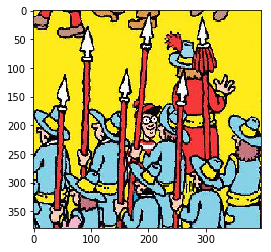

In [38]:
plt.imshow(imgs[0][wend-224:wstart+224,hend-224:hstart+224]*std+mu)

Nxt we'll define these as functions.

In [39]:
def extract_224_sub_image(img, box):
    wstart, wend, hstart,hend = box
    i = img[wend-224:wstart+224,hend-224:hstart+224]
    if i.shape[0]==0:
        return img[wstart:wstart+225,hend-224:hstart+224]
    else: 
        return i

In [40]:
def find_box(label):
    shp = label.shape
    h = np.max(np.unique(label.sum(axis=1)))
    hstart = np.argmax(label.sum(axis=0))
    hend = int(hstart+h)
    w = np.max(np.unique(label.sum(axis=0)))
    wstart = np.argmax(label.sum(axis=1))
    wend = int(wstart+w)
    return (wstart, wend, hstart, hend)

And we'll build these sub-images and corresponding labels for each image.

In [41]:
waldo_sub_imgs = []
waldo_sub_labels = []
for i, label in enumerate(labels):
    box = find_box(label)
    waldo_sub_imgs.append(extract_224_sub_image(imgs[i], box))
    waldo_sub_labels.append(extract_224_sub_image(label, box))

waldo_sub_imgs = np.array(waldo_sub_imgs)
waldo_sub_labels = np.array(waldo_sub_labels)

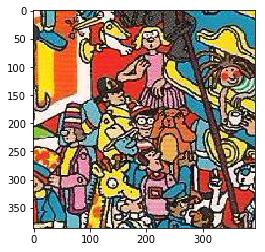

In [44]:
plt.imshow(waldo_sub_imgs[1]*std+mu)

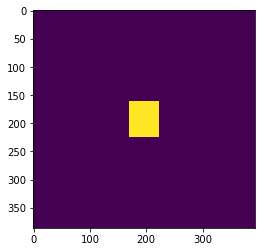

In [45]:
plt.imshow(waldo_sub_labels[1])

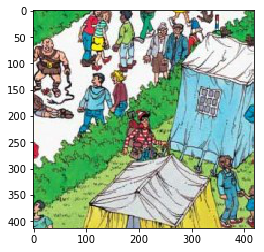

In [46]:
plt.imshow(waldo_sub_imgs[-1]*std+mu)

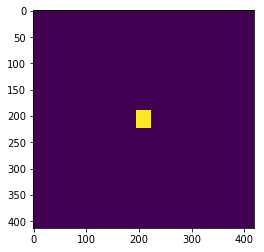

In [47]:
plt.imshow(waldo_sub_labels[-1])

The functions I put together only work well when the image has the requisite buffer around the target, when it doesn't you run into problems. As it stands, there's a conditional in <tt>extract_224_sub_image()</tt> that catches the one image I have that doesn't have this buffer and returns the appropriate image, but this naturally won't generalize.

Below is the sub-image in question.

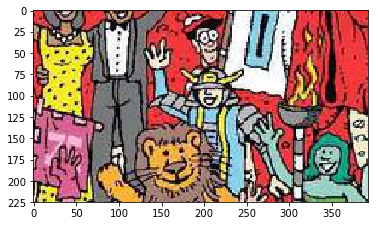

In [48]:
plt.imshow(waldo_sub_imgs[-2]*std+mu)

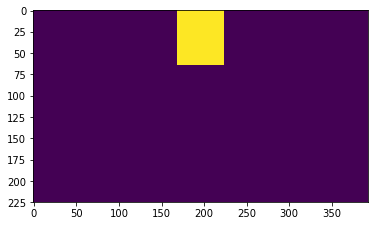

In [50]:
plt.imshow(waldo_sub_labels[-2])

I'm not sure how to best generalize this edge-case handling, however I don't expect this to be an issue often if ever at all.

Save them so we can reload 

In [90]:
np.save('waldo_sub_imgs.npy',waldo_sub_imgs)

In [91]:
np.save('waldo_sub_labels.npy',waldo_sub_labels)

In [11]:
waldo_sub_imgs = np.load('waldo_sub_imgs.npy')
waldo_sub_labels = np.load('waldo_sub_labels.npy')

## Iterators

Next are the iterators for generating our data. The first two are modified versions of iterators found in Jeremy Howard's Tiramisu [notebook](https://github.com/fastai/courses/blob/master/deeplearning2/tiramisu-keras.ipynb), part of  [fast.ai's](http://www.fast.ai/) [Cutting Edge Deep Learning for Coders](http://course.fast.ai/part2.html).

This iterator yields index batches, shuffled or otherwise, for sampling batches from an array.

In [10]:
class BatchIndices(object):
    """
    Generates batches of shuffled indices.
    # Arguments
        n: number of indices
        bs: batch size
        shuffle: whether to shuffle indices, default False 
    
    """
    def __init__(self, n, bs, shuffle=False):
        self.n,self.bs,self.shuffle = n,bs,shuffle
        self.lock = threading.Lock()
        self.reset()

    def reset(self):
        self.idxs = (np.random.permutation(self.n) 
                     if self.shuffle else np.arange(0, self.n))
        self.curr = 0

    def __next__(self):
        with self.lock:
            if self.curr >= self.n: self.reset()
            ni = min(self.bs, self.n-self.curr)
            res = self.idxs[self.curr:self.curr+ni]
            self.curr += ni
            return res

This generator is the one that creates the sample images. The output is a <tt>(input_batch, target_batch)</tt> tuple, which Keras expects when fitting on generators.



Since the Waldo sub-images are designed to always have Waldo in the 224x224 samples, we're going to use the full image to sample total negatives. Thus when sampling from the full images, we're going to skip any sample image that contains Waldo, either partially or in whole. 

In [11]:
class segm_generator(object):
    """
    Generates batches of sub-images.
    # Arguments
        x: array of inputs
        y: array of targets
        bs: batch size
        out_sz: dimension of sub-image
        train: If true, will shuffle/randomize sub-images
        waldo: If true, allow sub-images to contain targets.
    """
    def __init__(self, x, y, bs=64, out_sz=(224,224), train=True, waldo=True):
        self.x, self.y, self.bs, self.train = x,y,bs,train
        self.waldo = waldo
        self.n = x.shape[0]
        self.ri, self.ci = [], []
        for i in range(self.n):
            ri, ci, _ = x[i].shape
            self.ri.append(ri), self.ci.append(ci) 
        self.idx_gen = BatchIndices(self.n, bs, train)
        self.ro, self.co = out_sz
        self.ych = self.y.shape[-1] if len(y.shape)==4 else 1

    def get_slice(self, i,o):
        start = random.randint(0, i-o) if self.train else (i-o)
        return slice(start, start+o)

    def get_item(self, idx):
        slice_r = self.get_slice(self.ri[idx], self.ro)
        slice_c = self.get_slice(self.ci[idx], self.co)
        x = self.x[idx][slice_r, slice_c]
        y = self.y[idx][slice_r, slice_c]
        if self.train and (random.random()>0.5): 
            y = y[:,::-1]
            x = x[:,::-1]
        if not self.waldo and np.sum(y)!=0:
            return None
        return x, to_categorical(y, num_classes=2)

    def __next__(self):
        idxs = self.idx_gen.__next__()
        items = []
        for idx in idxs:
            item = self.get_item(idx)
            if item is not None:
                items.append(item)
        if not items:
            return None
        xs,ys = zip(*tuple(items))
        return np.stack(xs), np.stack(ys)

This is a generator wrapper for python 2 compatibility.

In [12]:
def seg_gen(x, y, bs=64, out_sz=(224,224), train=True, waldo=True):
    """
    Generator wrapper on iterators for python 2 compatibility.
    """
    sg = segm_generator(x=x, y=y, bs=bs, out_sz = out_sz ,train=train, waldo=waldo)
    while True:
        yield sg.__next__()

This allows us to mix the Waldo sub-images and the full image negatives.

In [13]:
def seg_gen_mix(x1, y1, x2, y2, tot_bs=4, prop=0.75, out_sz=(224,224), train=True):
    """
    Mixes generator output. The second generator is set to skip images that contain any positive targets.
    # Arguments
        x1, y1: input/targets for waldo sub-images
        x2, y2: input/targets for whole images
        tot_bs: total batch size
        prop: proportion of total batch size consisting of first generator output
    """
    n1 = int(tot_bs*prop)
    n2 = tot_bs - n1
    sg1 = segm_generator(x1, y1, n1, out_sz = out_sz ,train=train)
    sg2 = segm_generator(x2, y2, n2, out_sz = out_sz ,train=train, waldo=False)
    while True:
        out1 = sg1.__next__()
        out2 = sg2.__next__()
        if out2 is None:
            yield out1
        else:
            yield np.concatenate((out1[0], out2[0])), np.concatenate((out1[1], out2[1]))


In [58]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels)

In [59]:
X, y = next(gen_mix)

The input is what we expect it to look like.

In [60]:
X.shape

(4, 224, 224, 3)

The output however is slightly different. Essentially, the given target is flattened into <tt>224*224=50176</tt> length vector, and then one-hot encoded. This will be the output shape of the classifier for each pixel. 

Since this data is binary, we could have trained with a binary cross-entropy loss and skipped one-hot encoding. However, as we'll see this one-hot encoding is necessary to weight the classes in the loss function.

In [68]:
y.shape

(4, 50176, 2)

Waldo sub-image sample

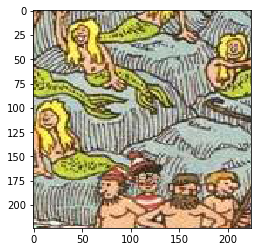

In [67]:
plt.imshow(X[0]*std+mu)

Waldo sub-image label

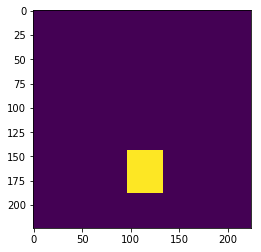

In [69]:
plt.imshow(y[0].reshape(224,224,2)[:,:,1])

Negative sub-image sample

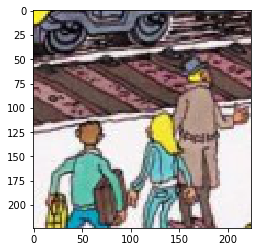

In [70]:
plt.imshow(X[-1]*std+mu)

Negative sub-image label.

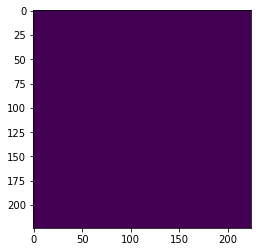

In [71]:
plt.imshow(y[-1].reshape(224,224,2)[:,:,1])

## Build Model

Now we're ready to build our model.

We're going to count the class frequency across the original labels. One common approach to correcting class imbalance is inverse frequency weighting.

In [72]:
freq0 = float(np.sum(labels==0))

freq1 = float(np.sum(labels==1))

In [73]:
freq0, freq1

(88666846.0, 37154.0)

However, I'm actually only going to weight the negatives by the inverse frequency, and keep the positives the same. Weighting the positives by inverse frequency is too much, and will prevent the mode from learning to be sensitive.

The Keras API only allows for class weighting on outputs if that output is a one-hot encoded vector. We have a sequence of 50176 one-hot encoded vectors, each one representing the classification of a pixel.

While we could technically create 50176 separate model outputs and apply the class weighting to each one that would be absurd.

There is another way called sample weighting. We're just going to create an array of the same shape as our target, then set all values in index 0 and 1 of one-hot encodings to be their respective class weights. During training, the model multiplies this sample-weight matrix element-wise with the output, and it accomplishes the same function.

In [74]:
class_weights = {0:1/freq0, 1:1.}

sample_weights = np.zeros((X.shape[0], X.shape[1] * X.shape[2], 2))

sample_weights.shape

sample_weights[:,:,0] = class_weights[0]

sample_weights[:,:,1] = class_weights[1]

As mentioned in the intro, we're going to be using the Tiramisu Fully Convolutional architecture. The code I use to build the architecture is again taken from Jeremy Howard's [implementation](https://github.com/fastai/courses/blob/master/deeplearning2/tiramisu-keras.ipynb), converted to Keras 2 API, and saved in the module tiramisu.py

If you are unfamiliar with this model, please take a look at Jeremy Howard's [implementation](https://github.com/fastai/courses/blob/master/deeplearning2/tiramisu-keras.ipynb) I mentioned earlier. 

(**Full Disclosure**: I wrote all prose in said notebook as intern for [fast.ai](fast.ai))

In [14]:
from tiramisu import *

In [15]:
import keras

Here we build and compile our model with our desired input shape. Notice the <tt>sample_weight_mode</tt> argument, this is to make the model compatible with the sample weights we discussed earlier.

In [16]:
input_shape = (224,224,3)

img_input = Input(shape=input_shape)
x = create_tiramisu(2, img_input, nb_layers_per_block=[4,5,7,10,12,15], p=0.2, wd=1e-4)
model = Model(img_input, x)

model.compile(loss='categorical_crossentropy', 
              optimizer=keras.optimizers.RMSprop(1e-3), metrics=["accuracy"], sample_weight_mode='temporal')

Here we grab our generator. This first part uses a 3:1 Waldo:No-Waldo ratio in the batch.

In [240]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels)

This is a callback that gives progess bars for jupyter notebook.

In [32]:
from keras_tqdm import TQDMNotebookCallback

tqdm = TQDMNotebookCallback()

Unfortunately this progress bar output doesn't persist in notebooks.

On a Titan X, it took ~4 s per batch.

In [241]:
model.fit_generator(gen_mix,steps_per_epoch=5, epochs=1, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

In [242]:
model.fit_generator(gen_mix,steps_per_epoch=5, epochs=1, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

In [243]:
model.fit_generator(gen_mix,steps_per_epoch=5, epochs=1, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

I ran this for about an hour and a half.

In [244]:
model.fit_generator(gen_mix,steps_per_epoch=5, epochs=1200, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

Let's see how it's doing.

In [245]:
h = model.history.history

Great. It learned alot fairly quickly. I would guess that at this point it's sorted out quite a bit of the negative, particular those in the Waldo sub-images since it sees that often.

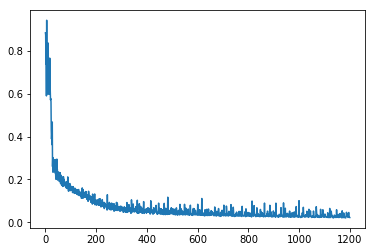

In [246]:
plt.plot(h['loss'])

In [41]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels)

In [42]:
X, y = next(gen_mix)

Let's observe qualitatively.

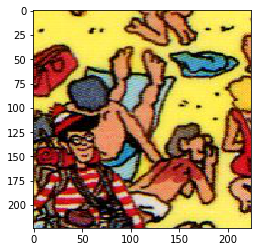

In [47]:
plt.imshow(X[1]*std+mu)

In [44]:
pred = model.predict_on_batch(X)

Well this is a great start! 

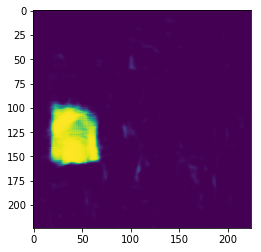

In [48]:
plt.imshow(pred[1].reshape(224,224,2)[:,:,1])

The most encouraging thing about seeing this is that it tells me the class weighting and batch mixing I'm doing is successfully mitigating the class-imbalance issue. I tried several other approaches before this one that resulted in ~0 sensitivity.

At this stage, the results are encouraging enough to simply let it keep training.

In [276]:
model.save('/data/bckenstler/waldo/models/model2_1200epochs.h5')

In [23]:
model.load_weights('/data/bckenstler/waldo/models/model2_1200epochs.h5')

Next, I increased my batch size to 6, with a 2:1 Waldo-No-Waldo ratio. This is about as large as I could get it given this massive architecture.

In [37]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels, tot_bs=6, prop=.67)

In [38]:
model.fit_generator(gen_mix,steps_per_epoch=3, epochs=1, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

In [40]:
model.fit_generator(gen_mix,steps_per_epoch=6, epochs=1, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

I trained this over night.

In [49]:
model.fit_generator(gen_mix,steps_per_epoch=6, epochs=5000, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

In [50]:
model.save('/data/bckenstler/waldo/models/model2_6200epochs.h5')

In [51]:
model.fit_generator(gen_mix,steps_per_epoch=6, epochs=2000, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

In [52]:
model.save('/data/bckenstler/waldo/models/model2_8200epochs.h5')

In [53]:
h3 = model.history.history

So it is still having these loss spikes as it sees some background it either hasn't seen before or often.

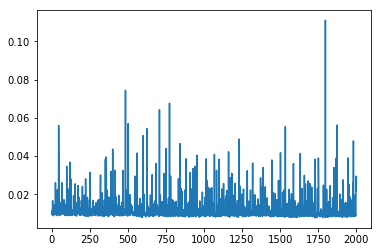

In [54]:
plt.plot(h3['loss'])

In [600]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels, tot_bs=6, prop=.67, train=False)

In [626]:
X, y = next(gen_mix)

In [602]:
X.shape

(6, 224, 224, 3)

In [629]:
preds = model.predict(X)

Let's see our results now.

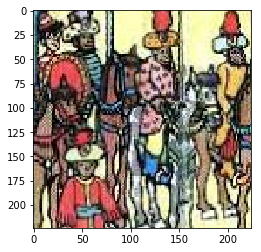

In [631]:
plt.imshow(X[1]*std+mu)

There is definitely more confidence here. The model has learned that locally, these objects come in rectangles, which is good. However there is still some noise.

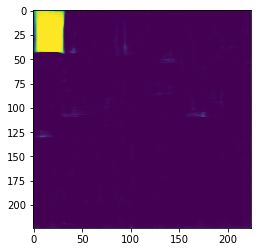

In [632]:
plt.imshow(preds[1].reshape(224,224,2)[:,:,1])

To get a better perspective at the performance of this model, let's look how it's doing across the entire image. 

I'll go into how exactly this is done later.

In [1]:
from PIL import Image

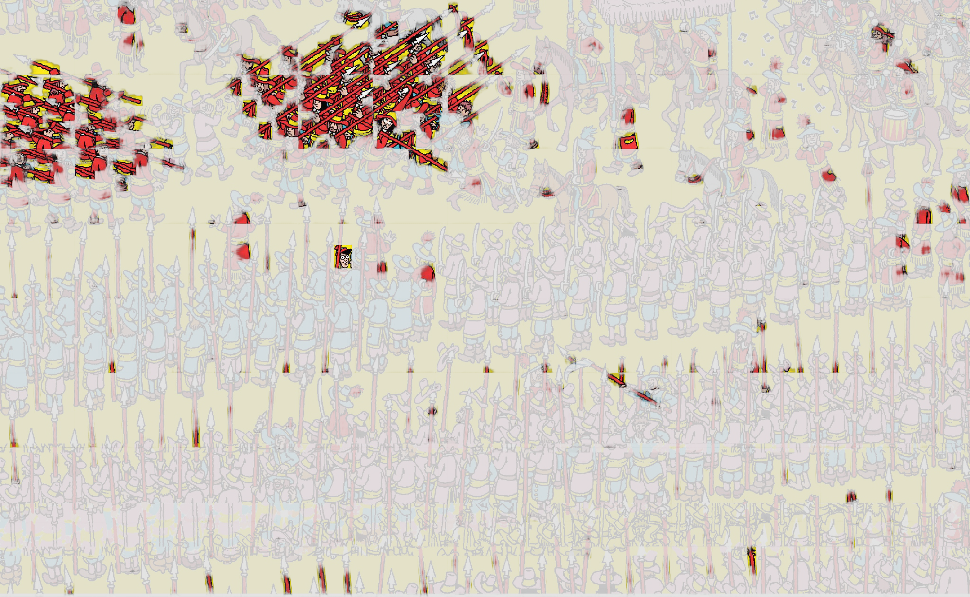

In [9]:
im = Image.open('imgs/full_predictions/0.png')
im.resize((im.size[0]//3, im.size[1]//3))

Ok, we can clearly see that the model has identified and boxed Waldo's face, however there is ALOT of messy noise in some other parts of the image. 

After looking at predictions from this model, it became clear that the model wasn't seeing enough negatives drawn from the rest of the image (recall the total number of unique image being ~142 million).

Therefore I trained for another 2000 epochs, this time with a 2:1 No-Waldo:Waldo ratio. My hope was that by seeing more negatives more often, the model will learn how to correctly classify them much faster.

In [656]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels, tot_bs=6, prop=.34)

In [657]:
model.fit_generator(gen_mix,steps_per_epoch=6, epochs=2000, verbose=0, callbacks=[tqdm], class_weight=sample_weights)

Let's see if this worked.

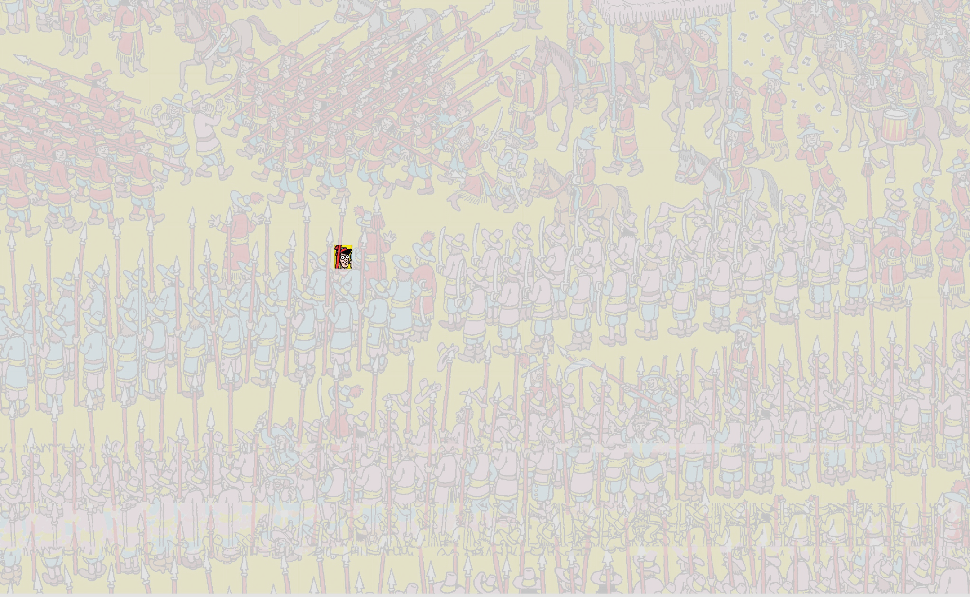

In [16]:
im = Image.open('imgs/full_predictions/new_0.png')
im.resize((im.size[0]//3, im.size[1]//3))

WOW

In [674]:
model.save('/data/bckenstler/waldo/models/model2_10200epochs.h5')

In [68]:
model.load_weights('/data/bckenstler/waldo/models/model2_10200epochs.h5')

## Predicting on Entire Image

Ok, so we knoww the model is working well. 

How exactly did we get to that prediction on the whole image?

Given that Tiramisu is a fully convolutional network, the theoretical model works on any input size. Practically implementations need to know the dimension ahead of time to build the model.

Fortunately, once we compile the model with this change reflected, we can just load the weights.

However, we still just can't put in the original images. They and this model are just too big, even for a forward pass alone.

This is one of the largest sizes I could manage, everything else follows as before.

In [28]:
lrg_img_size = (1120, 1120)

In [29]:
lrg_imgs = np.stack([load_image(img_file, lrg_img_size) for img_file in img_files])

lrg_labels = np.stack([load_label(trg_file, lrg_img_size) for trg_file in trg_files])

In [31]:
original_lrg_imgs = np.copy(lrg_imgs)

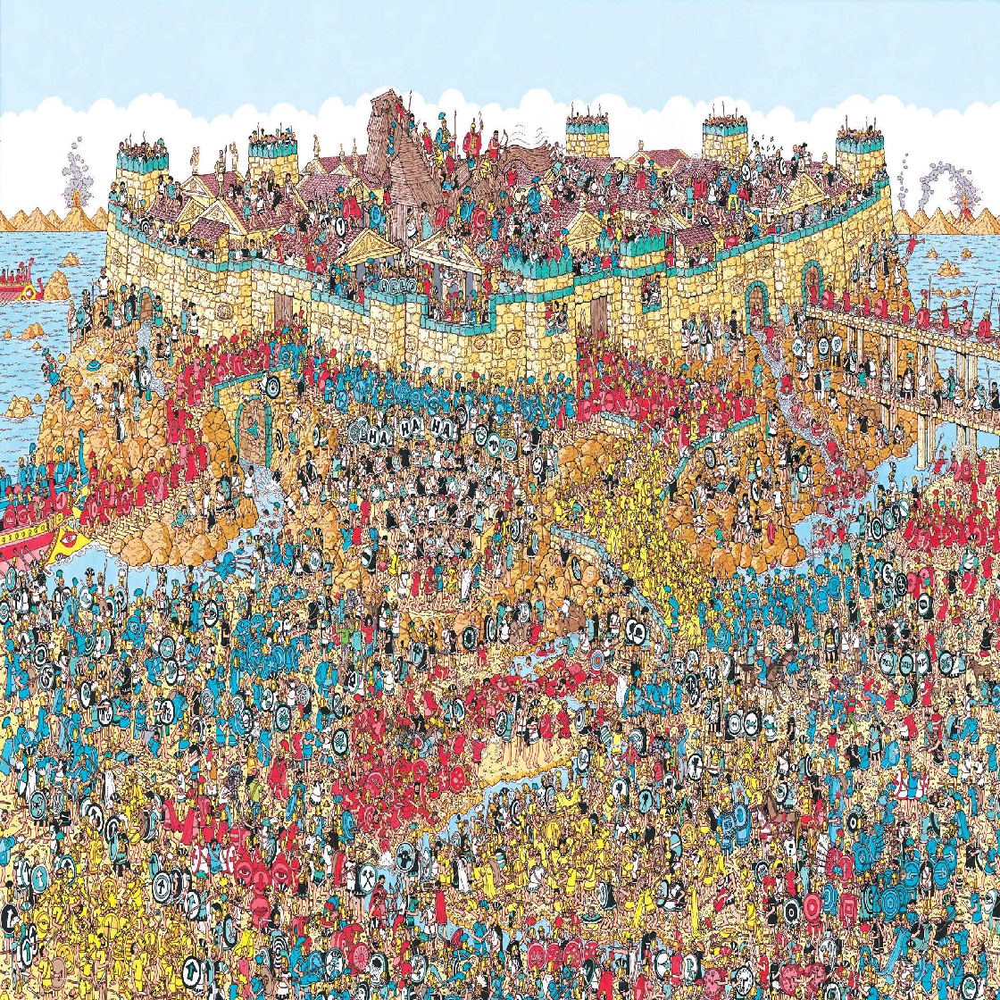

In [35]:
Image.fromarray(original_lrg_imgs[10])

In [62]:
lrg_imgs = lrg_imgs/255.

In [63]:
lrg_imgs -= mu
lrg_imgs /= std

In [64]:
lrg_input_shape = (1120, 1120, 3)

In [16]:
lrg_gen = seg_gen(imgs, labels, bs=1, out_sz=(1568, 2688), train=False)

In [17]:
X, y = next(lrg_gen)

In [65]:
lrg_img_input = Input(shape=lrg_input_shape)
lrg_x = create_tiramisu(2, lrg_img_input, nb_layers_per_block=[4,5,7,10,12,15], p=0.2, wd=1e-4)
lrg_model = Model(lrg_img_input, lrg_x)

In [45]:
lrg_model.compile(loss='categorical_crossentropy', 
              optimizer=keras.optimizers.RMSprop(1e-3), metrics=["accuracy"], sample_weight_mode='temporal')

In [584]:
lrg_model.load_weights('/data/bckenstler/waldo/models/model2_8200epochs.h5')

Only one could be predicted at a time.

In [585]:
preds = []
for img in lrg_imgs:
    preds.append(lrg_model.predict_on_batch(np.expand_dims(img, 0)))
preds = np.stack(preds)

In [106]:
p = (255.*(preds[10].reshape(1120,1120,2)[:,:,1])).astype('uint8')

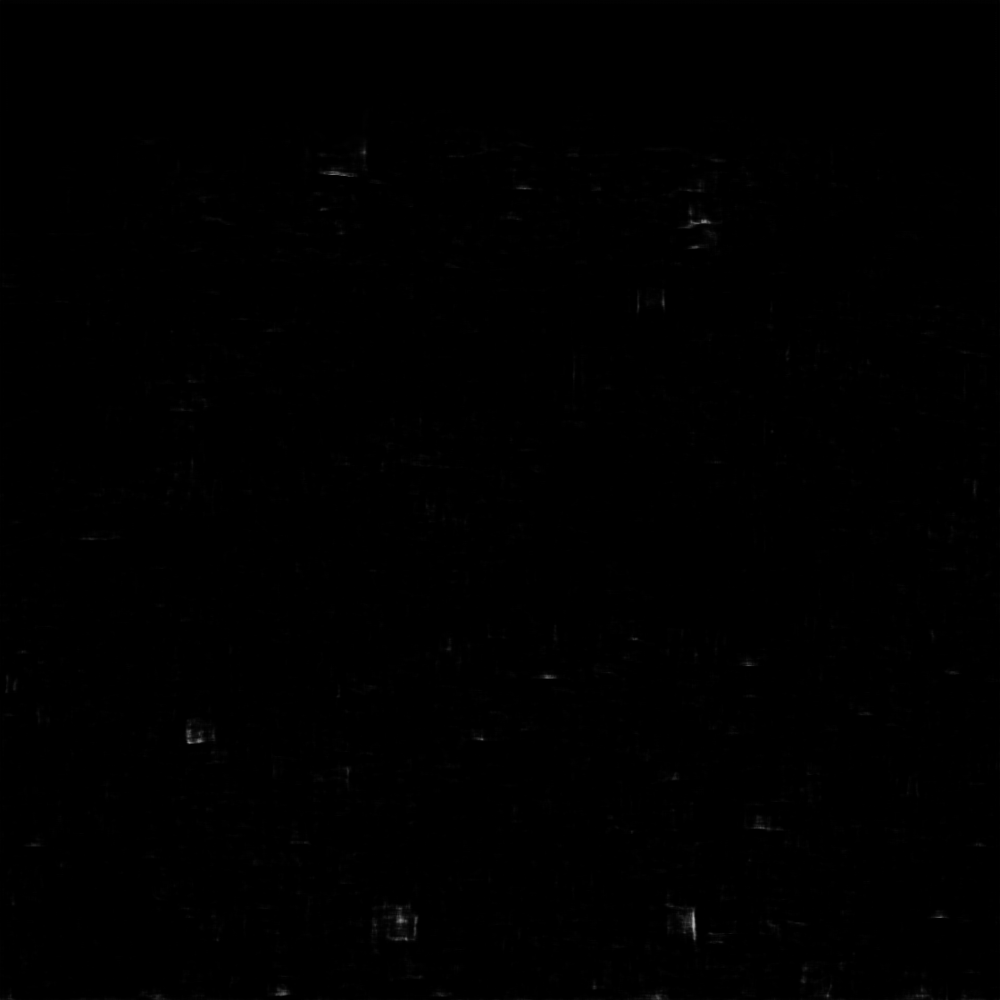

In [107]:
Image.fromarray(p)

That's not great!!! Why is this happening?

A quick look at Waldo in the image we loaded might give us a clue.

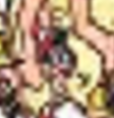

In [78]:
Image.open('imgs/bad_waldo.png')

He has been almost unrecognizably distorted. This and other tests have convinced me that this is a bad approach for this dataset.

Because the object we're trying to detect is so small in the image, downsampling the whole image and passing that through the model distorts the object too much.

## Prediction Scan

So what can we do? What use is this model if it doesn't work on the entire original image?

One work around is to load the image and predict across it in panels.

We're going to work with an image we've never seen before. We load it in the same resolution as the original images.

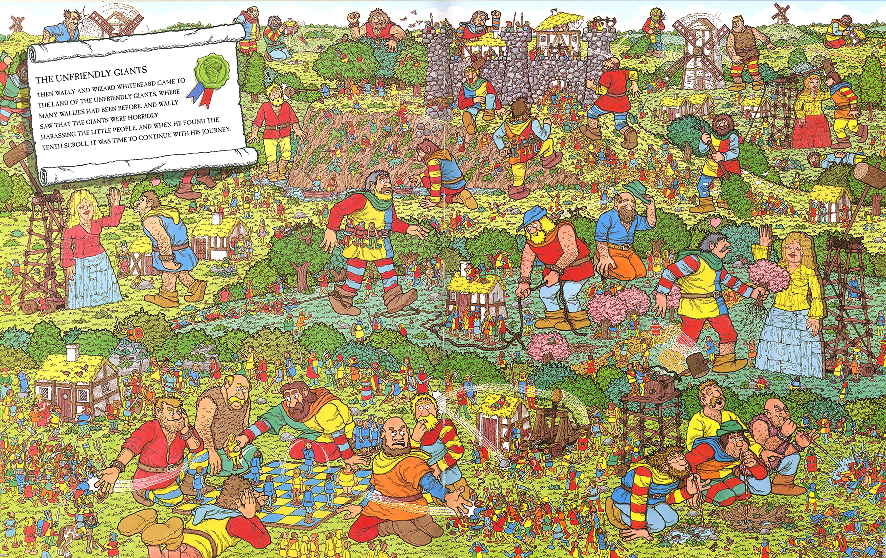

In [36]:
im = Image.open('imgs/new_imgs/giant_waldo.jpg')
im.resize((im.size[0]//2, im.size[1]//2))

In [41]:
new_imgs = np.stack([load_image(img_file, img_sz=img_sz) for img_file in ['imgs/new_imgs/giant_waldo.jpg']])

In [70]:
new_imgs[0].shape

(1760, 2800, 3)

In [42]:
from scipy.misc import imresize

What we want to do is to resize the input image dimensions that are multiples of 224, that way we can split the entire thing into 224x224 panels and predict each one

In [40]:
def img_resize(img):
    h, w, _ = img.shape
    nvpanels = h/224
    nhpanels = w/224
    new_h, new_w = h, w
    if nvpanels*224 != h:
        new_h = (nvpanels+1)*224
    if nhpanels*224 != w:
        new_w = (nhpanels+1)*224
    if new_h == h and new_w == w:
        return img
    else:
        return (imresize(img, (new_h, new_w))/255. - mu)/std

Next we're going to pull out all the panels (non-overlapping) from the image and save that in a new array.

In [43]:
def split_panels(img):
    h, w, _ = img.shape
    num_vert_panels = h/224
    num_hor_panels = w/224
    panels = []
    for i in range(num_vert_panels):
        for j in range(num_hor_panels):
            panels.append(img[i*224:(i+1)*224,j*224:(j+1)*224])
    return np.stack(panels)

We're going to also need to recombine these panels back into the resized image.

In [22]:
def combine_panels(img, panels):
    h, w, _ = img.shape
    num_vert_panels = h/224
    num_hor_panels = w/224
    total = []
    p = 0
    for i in range(num_vert_panels):
        row = []
        for j in range(num_hor_panels):
            row.append(panels[p])
            p += 1
        total.append(np.concatenate(row, axis=1))
    return np.concatenate(total, axis=0)

In [46]:
test_img = img_resize(new_imgs[0])

panels = split_panels(test_img)

In [73]:
out = combine_panels(test_img, panels)

img:

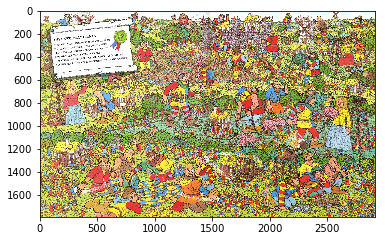

In [74]:
plt.imshow(test_img*std+mu)

An example panel:

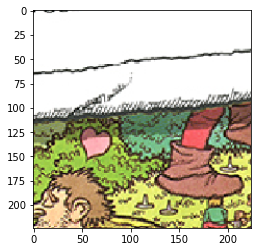

In [75]:
plt.imshow(panels[28]*std+mu)

Re-assembled image:

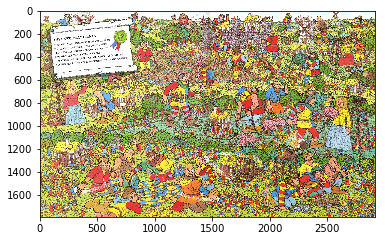

In [76]:
plt.imshow(out*std+mu)

Now we're going to make predictions on all the panels.

Batch size of 6 is the largest I could go.

In [77]:
pred_panels = model.predict(panels, batch_size=6)

Helper function to reshape the model outputs.

In [78]:
def reshape_pred(pred): return pred.reshape(224,224,2)[:,:,1]

In [79]:
pred_panels = np.stack([reshape_pred(pred) for pred in pred_panels])

Re-assemble

In [80]:
pred_out = combine_panels(test_img, pred_panels)

This looks good, lets take a closer look.

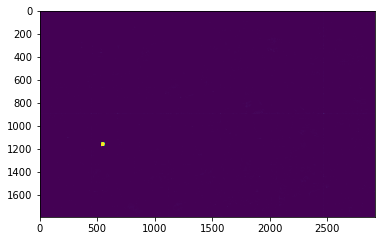

In [81]:
plt.imshow(pred_out)

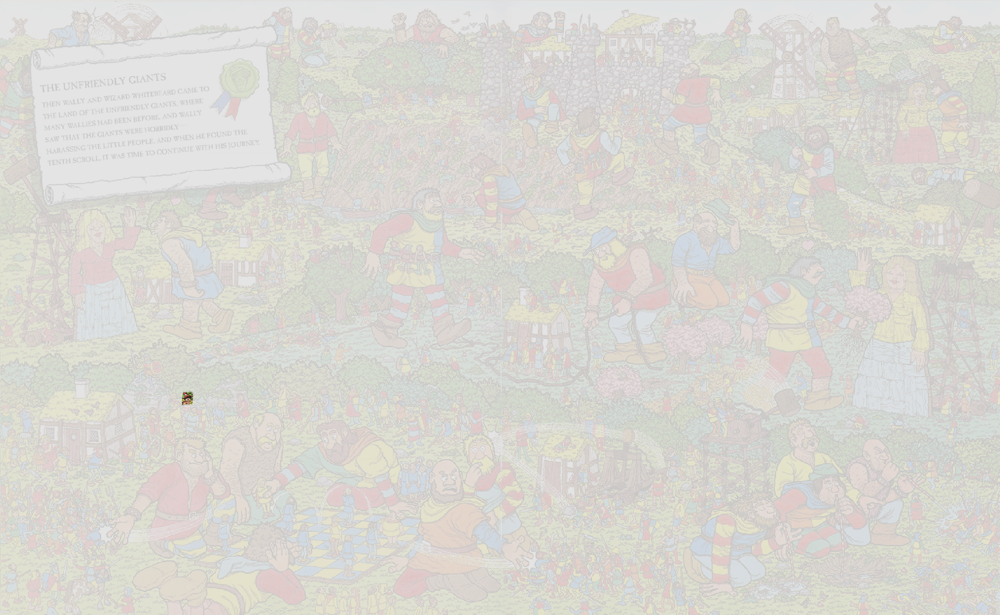

In [37]:
im = Image.open('imgs/new_img_predictions/8.png')
im.resize((im.size[0]//2, im.size[1]//2))

That looks great!!! A quick zoom will show you it's clearly boxed Waldo. And nothing else.

There are of course some draw backs from this approach, mainly that weird things might happen at the literal edge cases. We already know that given the object size, panels of this dimension are not a problem. What is a problem is if for example Waldo gets split in half by two panels. Here is one example:

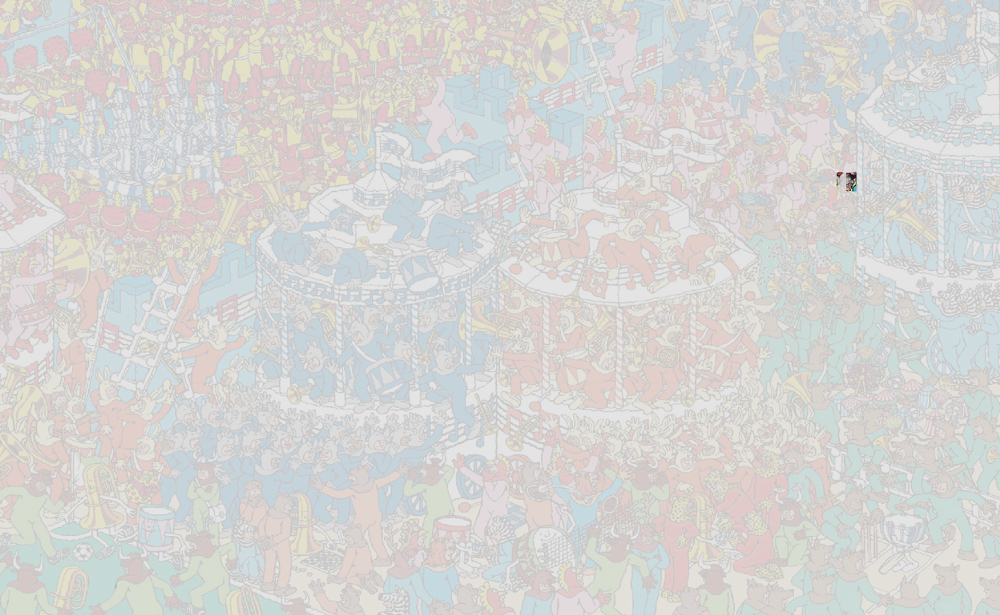

In [38]:
im = Image.open('imgs/full_predictions/new_5.png')
im.resize((im.size[0]//2, im.size[1]//2))

Even though this image is from the training set, we can clearly see some problems occurring because the panel was split right in the middle.

One possible approach for dealing with this is to create slightly overlapping panels, and average the results of the overlapping pixels.

## Produce Heatmap

How do we create those cool heatmaps?

We need to create the PIL Image objects.

In [47]:
layer1 = Image.fromarray(((test_img*std+mu)*255).astype('uint8'))

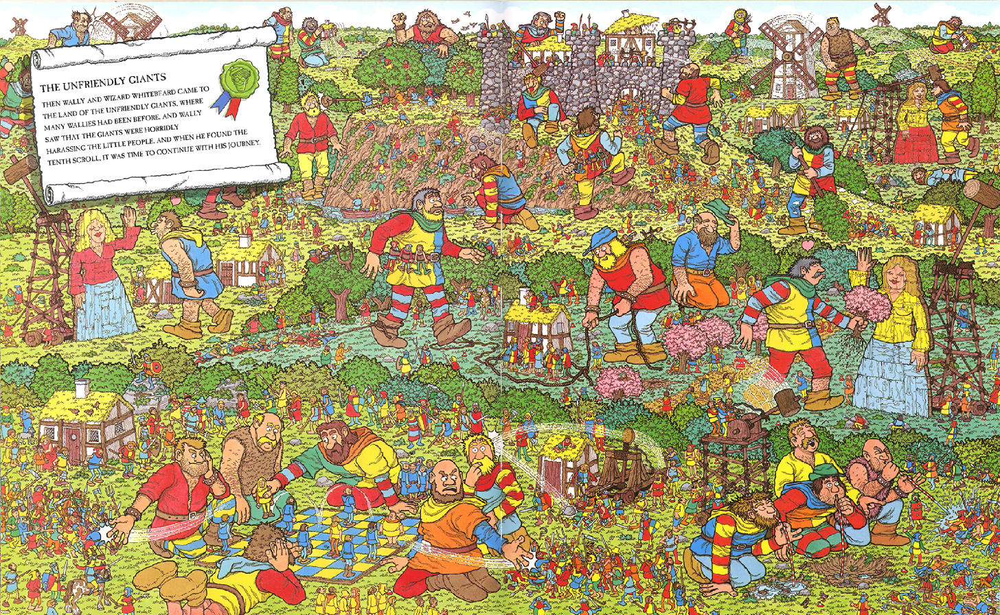

In [48]:
layer1.resize((im.size[0]//2, im.size[1]//2))

The prediction has no channel dimension. We're going to copy (1-prediction) four times and stack that into an image array with four channels, all the same value, with the fourth representing Alpha. Alpha is a transparency channel.

In [89]:
layer2 = Image.fromarray(np.concatenate(4*[np.expand_dims((225*(1-pred_out)).astype('uint8'), axis=-1)], axis=-1))

Therefore we're making the regions without Waldo opaque.

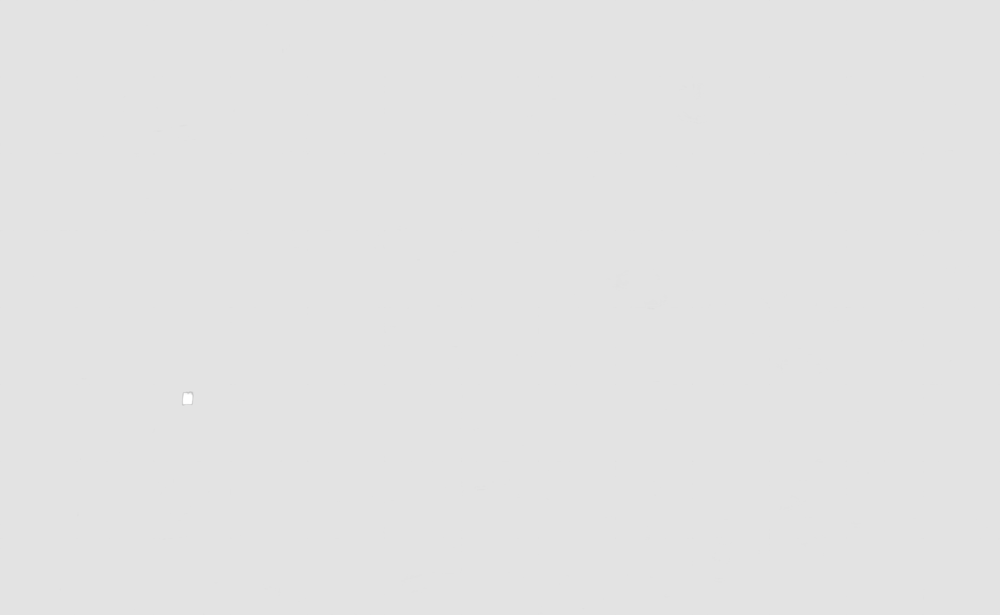

In [90]:
layer2

Next we stack these on top of a new image.

In [91]:
final2 = Image.new("RGBA", layer1.size)

final2 = Image.alpha_composite(final2, layer1.convert('RGBA'))

final2 = Image.alpha_composite(final2, layer2)

And there we have it.

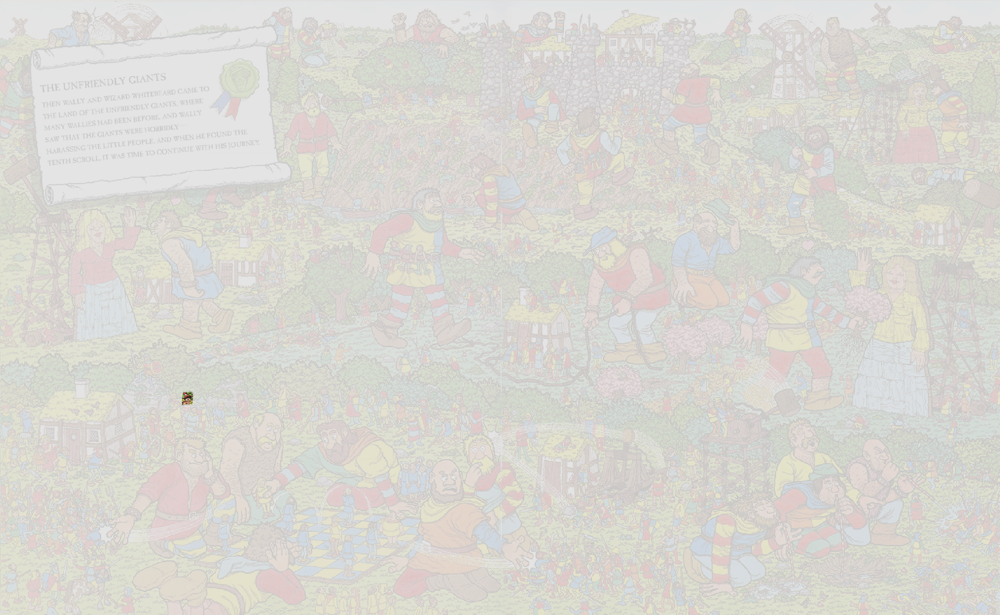

In [49]:
im = Image.open('imgs/new_img_predictions/8.png')
im.resize((im.size[0]//2, im.size[1]//2))

This function does the process we just went over.

In [550]:
def prediction_mask(img, target):
    layer1 = Image.fromarray(((img*std+mu)*255).astype('uint8'))
    layer2 = Image.fromarray(
        np.concatenate(
            4*[np.expand_dims((225*(1-target)).astype('uint8'), axis=-1)],
            axis=-1))
    result = Image.new("RGBA", layer1.size)
    result = Image.alpha_composite(result, layer1.convert('RGBA'))
    return Image.alpha_composite(result, layer2)

In [518]:
pred_mask = prediction_mask(test_img, pred_out)

In [519]:
pred_mask.save('test_pred.png')

## Create all predictions on train imgs, new imgs

Now we can wrap the end to end process up in the following function.

In [93]:
def waldo_predict(img):
    rimg = img_resize(img)
    panels = split_panels(rimg)
    pred_panels = model.predict(panels, batch_size=6)
    pred_panels = np.stack([reshape_pred(pred) for pred in pred_panels])
    return rimg, combine_panels(rimg, pred_panels)

And make predictions on all original images.

In [661]:
for i, full_img in enumerate(imgs):
    full_img_r, full_pred = waldo_predict(full_img)
    mask = prediction_mask(full_img_r, full_pred)
    mask.save(FULL_PRED_PATH+'new_' +str(i)+'.png')

And on new images!

In [97]:
new_imgs = [load_image(os.path.join(NEW_PATH,img_file), img_sz) for img_file in ['XFDYpn1.jpg', 'drNkw1G.jpg', '9fTlIwB.jpg',
                                                          'o5ZeoLC.jpg','LqaRsv0.jpg','zlVZYg3.jpg',
                                                         'yZ4Nqth.jpg', 'maps_future.jpg']]

In [ ]:
for i, full_img in enumerate(new_imgs):
    full_img_r, full_pred = waldo_predict(full_img)
    mask = prediction_mask(full_img_r, full_pred)
    mask.save(str(i)+'.png')

On a Titan X:

In [676]:
%timeit full_img_r, full_pred = waldo_predict(load_image('giant_waldo.jpg', img_sz))



1 loop, best of 3: 7.16 s per loop


And that's it!